In [1]:
# Imports
import os
import random
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from tqdm import tqdm

from utils.Siren_LIIF_style_utils import(
    get_mgrid_2d,
    SingleImagePatchDataset,
    ConditionedSiren,
)

## For this version of LIIF with Siren, we train the model using patches from multiple images and then test it by reconstructing a full image it has never seen before.

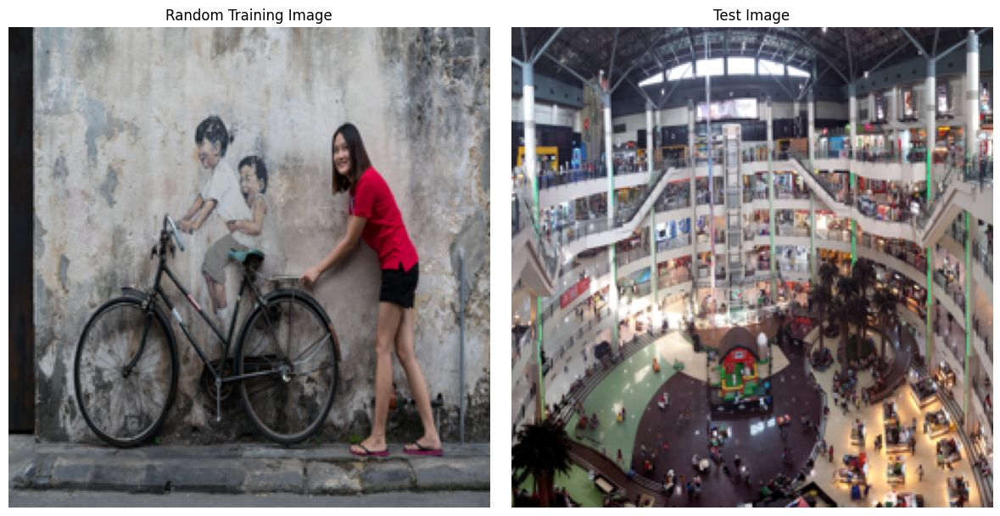

In [2]:
# data_folder = 'data' # Used for testing
data_folder = 'data/archive/DIV2K_train_HR/'
image_paths = [os.path.join(data_folder, fname) for fname in os.listdir(data_folder) if fname.endswith(('.png', '.jpg', '.jpeg'))]

# Parameter: Number of images to use for training
num_train_images = 4

# Randomly select a single image for testing
test_image_path = random.choice(image_paths)

# Select training images (exclude the test image)
train_image_paths = [path for path in image_paths if path != test_image_path]
train_image_paths = random.sample(train_image_paths, num_train_images)

# Load datasets
train_datasets = [SingleImagePatchDataset(path) for path in train_image_paths]
test_dataset = SingleImagePatchDataset(test_image_path)

# Combine training datasets
combined_dataset = torch.utils.data.ConcatDataset(train_datasets)

# DataLoader
train_loader = DataLoader(combined_dataset, batch_size=2048, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=2048, shuffle=False)

# Initialize model, optimizer, and device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ConditionedSiren().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

random_train_image = random.choice(train_datasets).img_tensor.permute(1, 2, 0).cpu().numpy()
test_image = test_dataset.img_tensor.permute(1, 2, 0).cpu().numpy()

# Denormalize images
random_train_image = (random_train_image + 1) / 2
test_image = (test_image + 1) / 2

# Plot
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(random_train_image.clip(0, 1))
plt.title("Random Training Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(test_image.clip(0, 1))
plt.title("Test Image")
plt.axis('off')

plt.tight_layout()
plt.show()


Training Progress:   5%|▌         | 1/20 [00:41<13:04, 41.31s/it]

Epoch 1, Loss: 0.0240
Epoch 2, Loss: 0.0042


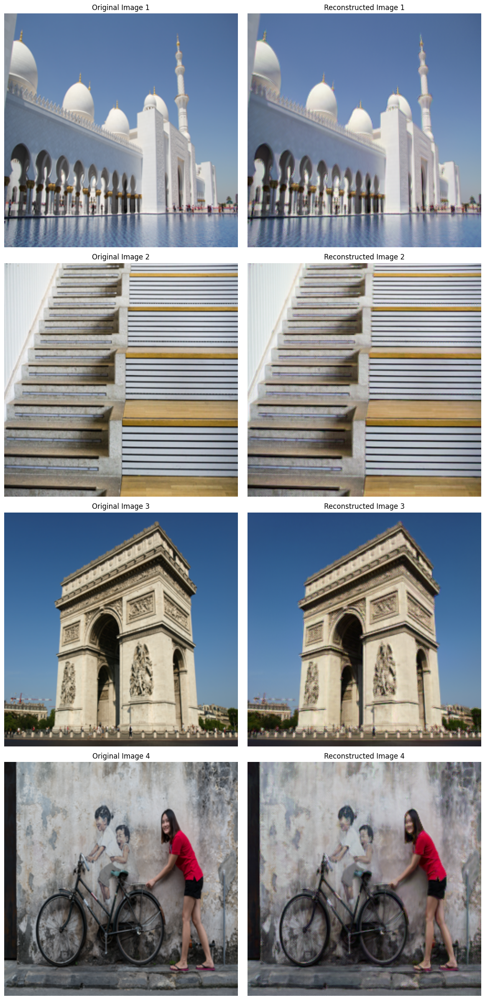

Training Progress:  15%|█▌        | 3/20 [02:01<11:24, 40.26s/it]

Epoch 3, Loss: 0.0034
Epoch 4, Loss: 0.0031


<Figure size 640x480 with 0 Axes>

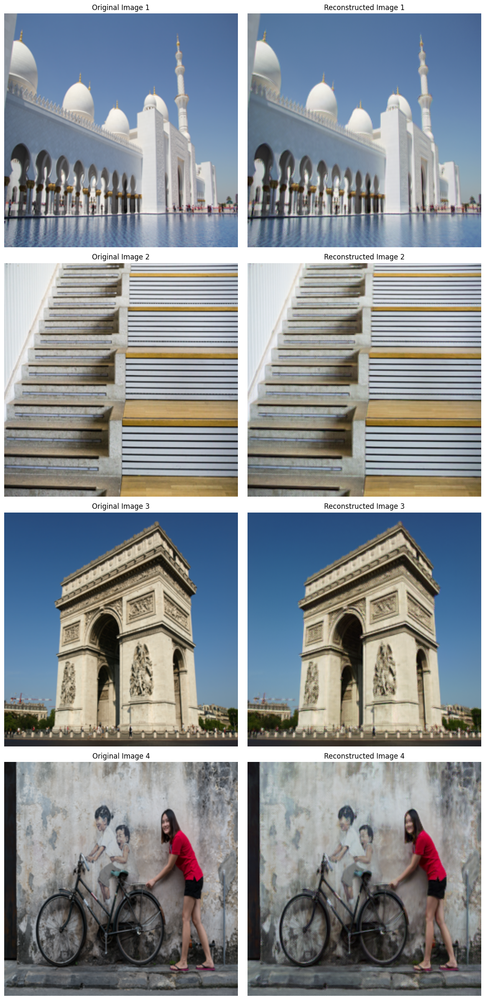

Training Progress:  25%|██▌       | 5/20 [03:24<10:20, 41.35s/it]

Epoch 5, Loss: 0.0029
Epoch 6, Loss: 0.0027


<Figure size 640x480 with 0 Axes>

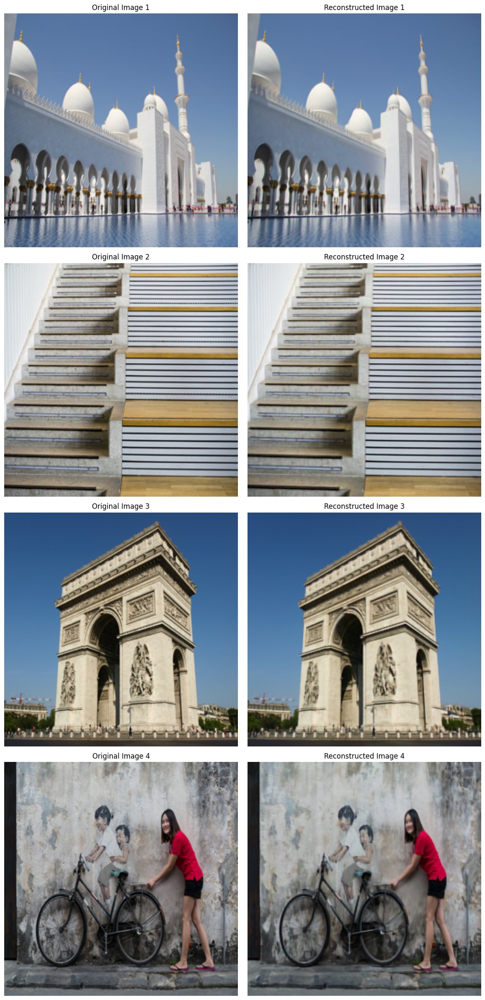

Training Progress:  35%|███▌      | 7/20 [04:58<09:38, 44.47s/it]

Epoch 7, Loss: 0.0026
Epoch 8, Loss: 0.0025


<Figure size 640x480 with 0 Axes>

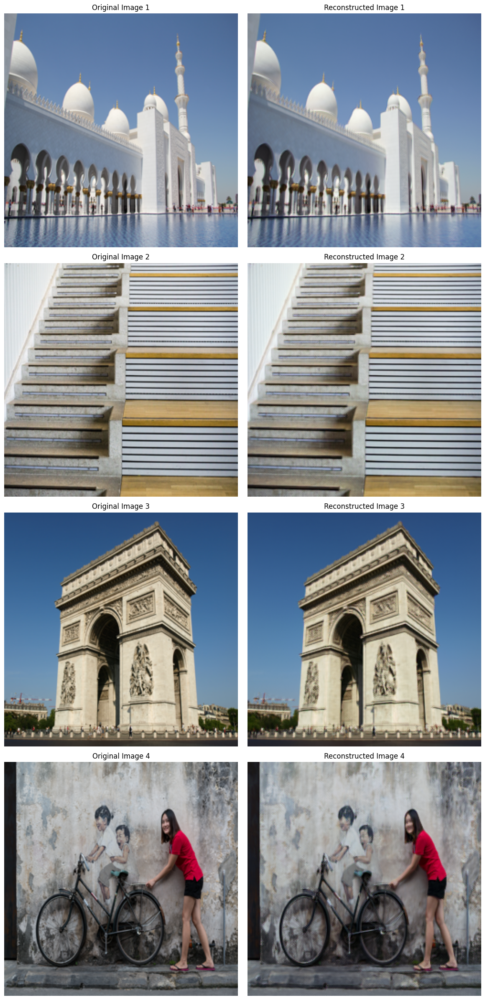

Training Progress:  45%|████▌     | 9/20 [06:33<08:27, 46.11s/it]

Epoch 9, Loss: 0.0025
Epoch 10, Loss: 0.0024


<Figure size 640x480 with 0 Axes>

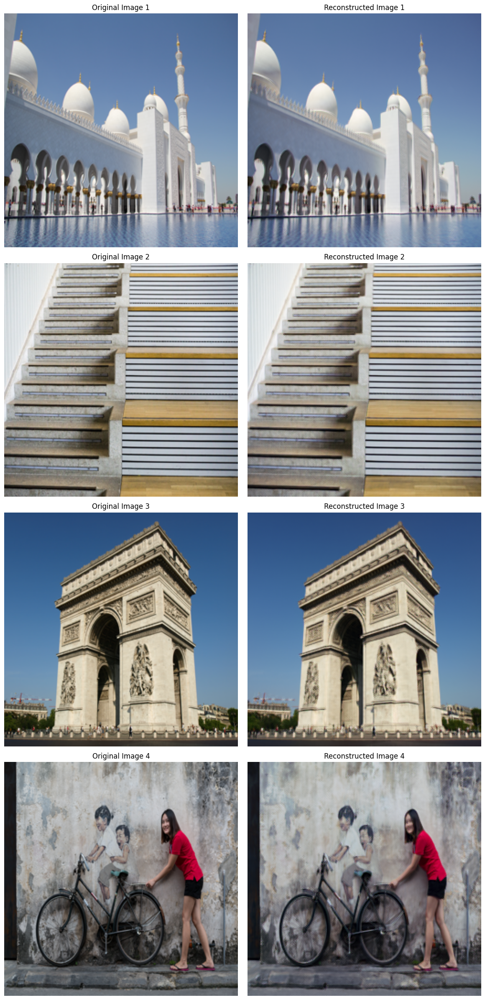

Training Progress:  55%|█████▌    | 11/20 [08:04<06:51, 45.77s/it]

Epoch 11, Loss: 0.0023
Epoch 12, Loss: 0.0023


<Figure size 640x480 with 0 Axes>

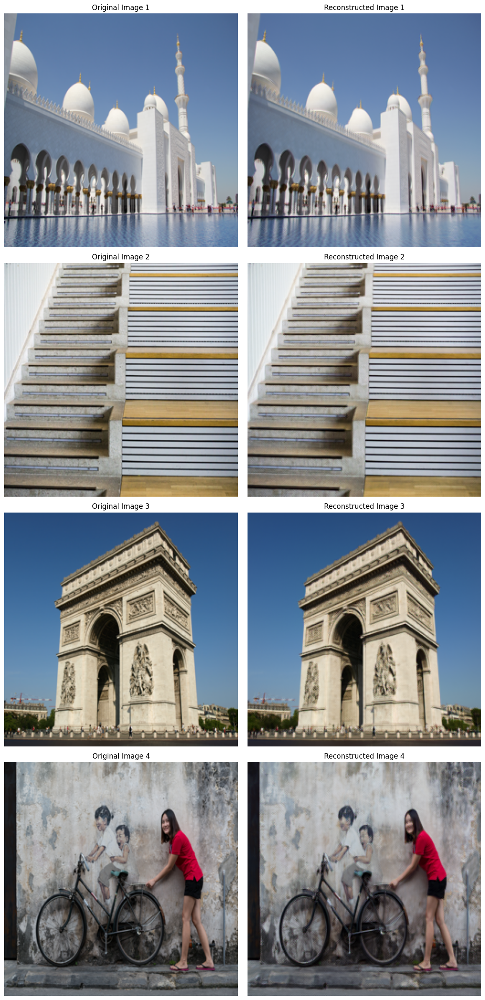

Training Progress:  65%|██████▌   | 13/20 [09:37<05:21, 45.99s/it]

Epoch 13, Loss: 0.0023
Epoch 14, Loss: 0.0022


<Figure size 640x480 with 0 Axes>

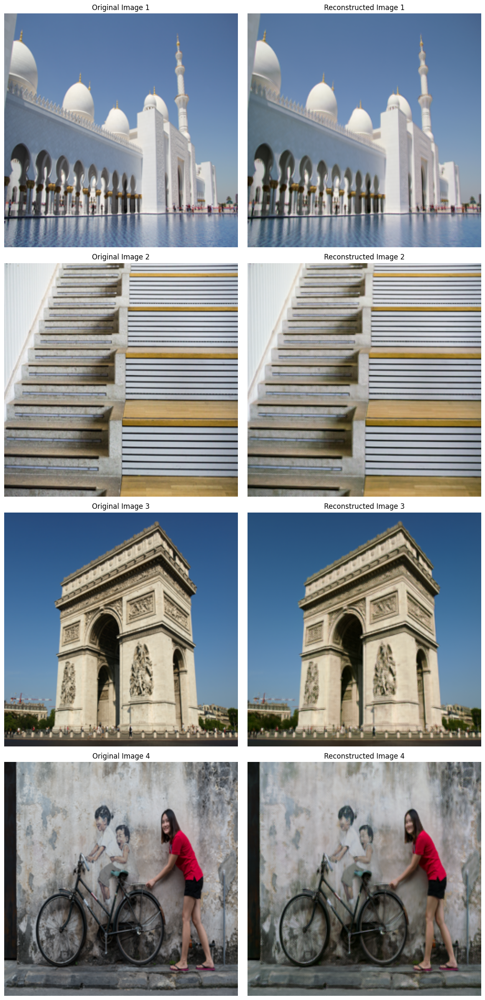

Training Progress:  75%|███████▌  | 15/20 [11:13<03:55, 47.04s/it]

Epoch 15, Loss: 0.0022
Epoch 16, Loss: 0.0021


<Figure size 640x480 with 0 Axes>

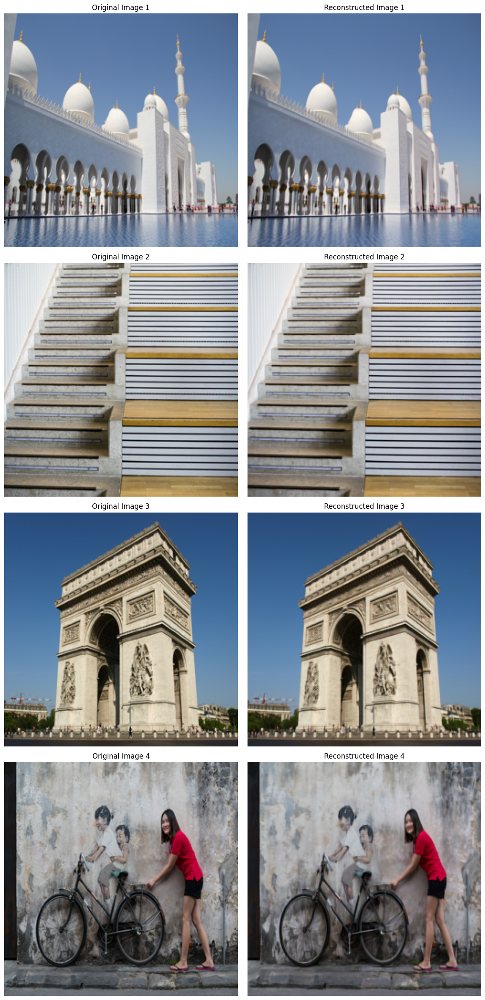

Training Progress:  85%|████████▌ | 17/20 [12:51<02:23, 47.85s/it]

Epoch 17, Loss: 0.0021
Epoch 18, Loss: 0.0021


<Figure size 640x480 with 0 Axes>

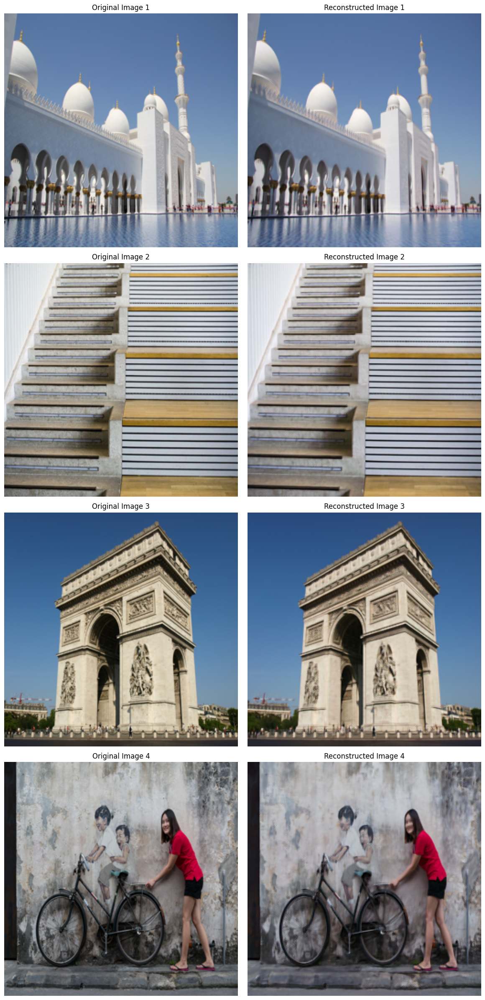

Training Progress:  95%|█████████▌| 19/20 [14:29<00:48, 48.63s/it]

Epoch 19, Loss: 0.0021
Epoch 20, Loss: 0.0020


<Figure size 640x480 with 0 Axes>

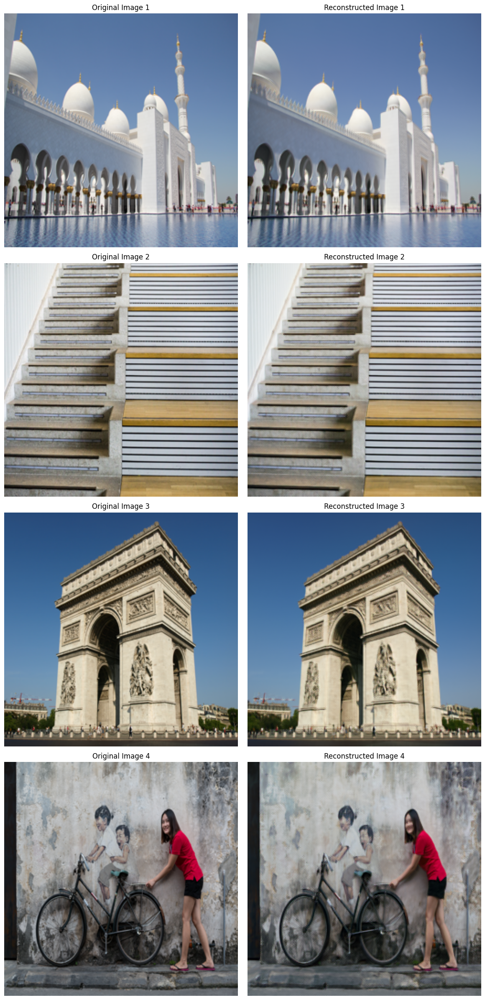

Training Progress: 100%|██████████| 20/20 [15:18<00:00, 45.90s/it]


<Figure size 640x480 with 0 Axes>

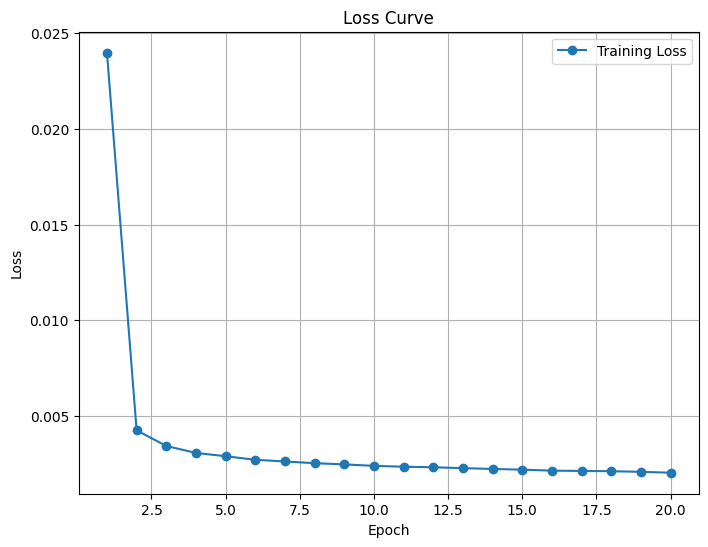

In [3]:
# Track losses
losses = []
epochs = 20

visualize_every = 2  # Show image every 2 epochs
pad = combined_dataset.datasets[0].pad_size  # Use the pad size from one of the datasets in combined_dataset

# Training loop
for epoch in tqdm(range(epochs), desc="Training Progress"):
    epoch_loss = 0  # Track loss for the current epoch

    for batch in train_loader:
        coords = batch['coord'].to(device)
        patches = batch['patch'].to(device)
        targets = batch['target'].to(device)

        # Forward pass
        preds = model(coords, patches)
        loss = F.mse_loss(preds, targets)

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Accumulate loss
        epoch_loss += loss.item()

    # Average loss for the epoch
    epoch_loss /= len(train_loader)
    losses.append(epoch_loss)

    print(f"Epoch {epoch + 1}, Loss: {epoch_loss:.4f}")

    # Visualization every `visualize_every` epochs
    if (epoch + 1) % visualize_every == 0:
        model.eval()
        with torch.no_grad():
            num_datasets = len(combined_dataset.datasets)
            plt.figure(figsize=(12, 6 * num_datasets))  # Adjust figure size for multiple rows

            for i, dataset in enumerate(combined_dataset.datasets):
                # Create full grid inference for each dataset in combined_dataset
                all_coords = dataset.coords.to(device)

                # Get all patches at once using unfold
                padded_img = F.pad(dataset.img_tensor.unsqueeze(0), (pad,) * 4, mode='reflect')[0]  # 1xCxHxW
                patches = padded_img.unfold(1, 3, 1).unfold(2, 3, 1)  # CxHxWx3x3
                patches = patches.permute(1, 2, 0, 3, 4)  # HxWxCx3x3
                patches = patches.reshape(-1, 3, 9)  # (H*W)x3x9
                # Remove center pixels (index 4 in each channel's 3x3 patch)
                patches = torch.cat([patches[:, :, :4], patches[:, :, 5:]], dim=2)  # (H*W)x3x8
                patches = patches.reshape(-1, 24)  # (H*W)x24

                # Predict full image
                preds = model(all_coords, patches.to(device))
                reconstructed = preds.cpu().numpy().reshape(dataset.img_tensor.shape[1],
                                                            dataset.img_tensor.shape[2], 3)

                # Denormalize
                reconstructed = (reconstructed + 1) / 2
                original = (dataset.img_tensor.permute(1, 2, 0).cpu().numpy() + 1) / 2

                # Plot original image
                plt.subplot(num_datasets, 2, 2 * i + 1)
                plt.imshow(original.clip(0, 1))
                plt.title(f"Original Image {i + 1}")
                plt.axis('off')

                # Plot reconstructed image
                plt.subplot(num_datasets, 2, 2 * i + 2)
                plt.imshow(reconstructed.clip(0, 1))
                plt.title(f"Reconstructed Image {i + 1}")
                plt.axis('off')

            plt.tight_layout()
            plt.pause(0.01)
            plt.draw()

        model.train()

# Plot the loss curve
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(losses) + 1), losses, marker='o', label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss Curve')
plt.legend()
plt.grid()
plt.show()

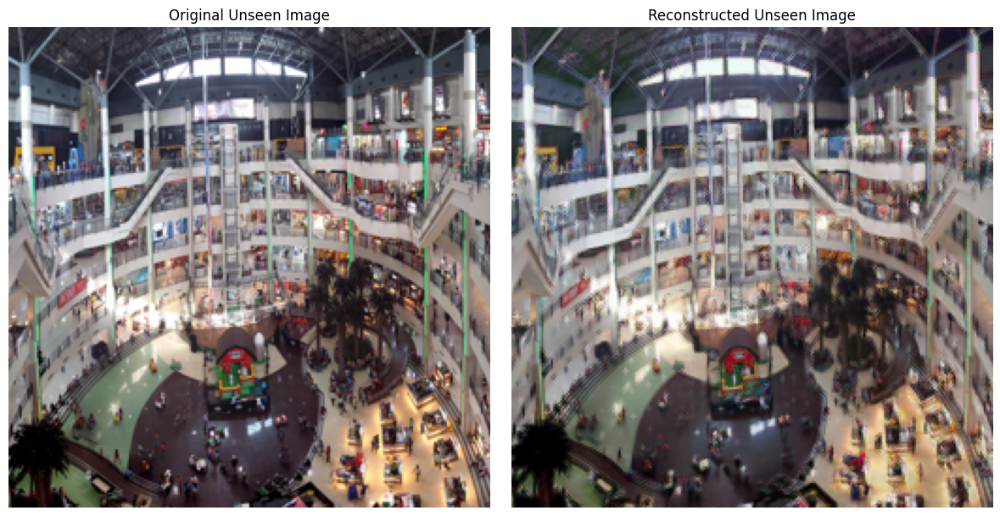

In [4]:
# Move the model to evaluation mode
model.eval()

# Get the original unseen image for comparison
original_unseen_img = (test_dataset.img_tensor.permute(1, 2, 0).cpu().numpy() + 1) / 2

# Create a grid of coordinates for the unseen image
all_coords = test_dataset.coords.to(device)

# Get all patches for the unseen image
pad = test_dataset.pad_size
padded_img = F.pad(test_dataset.img_tensor.unsqueeze(0), (pad,) * 4, mode='reflect')[0]  # 1xCxHxW
patches = padded_img.unfold(1, 3, 1).unfold(2, 3, 1)  # CxHxWx3x3
patches = patches.permute(1, 2, 0, 3, 4)  # HxWxCx3x3
patches = patches.reshape(-1, 3, 9)  # (H*W)x3x9
# Remove center pixels (index 4 in each channel's 3x3 patch)
patches = torch.cat([patches[:, :, :4], patches[:, :, 5:]], dim=2)  # (H*W)x3x8
patches = patches.reshape(-1, 24)  # (H*W)x24

# Predict the unseen image
with torch.no_grad():
    preds = model(all_coords, patches.to(device))
    reconstructed_unseen_img = preds.cpu().numpy().reshape(test_dataset.img_tensor.shape[1],
                                                           test_dataset.img_tensor.shape[2], 3)

# Denormalize the reconstructed image
reconstructed_unseen_img = (reconstructed_unseen_img + 1) / 2

# Visualize the original and reconstructed unseen image
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(original_unseen_img.clip(0, 1))
plt.title("Original Unseen Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(reconstructed_unseen_img.clip(0, 1))
plt.title("Reconstructed Unseen Image")
plt.axis('off')

plt.tight_layout()
plt.show()